In [2]:
import pandas as pd
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.metrics import mean_squared_error, mean_absolute_error
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 
from pandas_profiling import ProfileReport
import math

from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant  
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant  
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

from sklearn.metrics import confusion_matrix,plot_roc_curve, classification_report
from sklearn.metrics import mean_absolute_error , mean_squared_error , accuracy_score
from mlxtend.plotting import plot_confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

https://www.kaggle.com/datasets/whenamancodes/credit-card-customers-prediction

https://www.kaggle.com/code/teowaihong/credit-card-customers-prediction-with-sklearn



A business manager of a consumer credit card portfolio is facing the problem of customer attrition. They want to analyze the data to find out the reason behind this and leverage the same to predict customers who are likely to drop off. 


CLIENTNUM	Client number. Unique identifier for the customer holding the account

Attrition_Flag	Internal event (customer activity) variable - if the account is closed then 1 else 0

Customer_Age	Demographic variable - Customer's Age in Years

Gender	Demographic variable - M=Male, F=Female

Dependent_count	Demographic variable - Number of dependents

Education_Level	Demographic variable - Educational Qualification of the account holder (example: high school, college graduate, etc.)

Marital_Status	Demographic variable - Married, Single, Divorced, Unknown

Income_Category	Demographic variable - Annual Income Category of the account holder (< $40K, $40K - 60K, $60K - $80K, $80K-$120K, >

Card_Category	Product Variable - Type of Card (Blue, Silver, Gold, Platinum)

Monthsonbook	Period of relationship with bank

TotalRelationshipcount	Total no. of products held by the customer

MonthsInactive12_mon	No. of months inactive in the last 12 months

ContactsCount12_mon	No. of Contacts in the last 12 months

Credit_Limit	Credit Limit on the Credit Card

TotalRevolvingBal	Total Revolving Balance on the Credit Card

AvgOpenTo_Buy	Open to Buy Credit Line (Average of last 12 months)

TotalAmtChngQ4Q1	Change in Transaction Amount (Q4 over Q1)

TotalTransAmt	Total Transaction Amount (Last 12 months)

TotalTransCt	Total Transaction Count (Last 12 months)

TotalCtChngQ4Q1	Change in Transaction Count (Q4 over Q1)

AvgUtilizationRatio	Average Card Utilization Ratio

NaiveBayesClassifier_attribution	Naive Bayes

NaiveBayesClassifier_attribution	Naive Bayes

In [7]:
df = pd.read_csv('BankChurners.csv')

In [8]:
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.99991
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.99994
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.99998
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.99987
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.99998


In [104]:
df = df.rename(columns={df.columns[-2]: 'attrition1', df.columns[-1]: 'attrition2'})
df['Total_Ct_Chng_Q4_Q1'].value_counts()

1.000    123
0.667    123
0.500    119
0.750    108
0.600     87
        ... 
0.939      1
1.150      1
1.074      1
0.189      1
0.918      1
Name: Total_Ct_Chng_Q4_Q1, Length: 771, dtype: int64

In [10]:
df_processed = pd.DataFrame()

In [11]:
profile = ProfileReport(df)

In [12]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [13]:
df_processed['attrition_flag'] = df['Attrition_Flag'].map({'Existing Customer': 0, 'Attrited Customer': 1})
df_processed.head()

,attrition_flag
0,0
1,0
2,0
3,0
4,0


In [14]:
df_processed['age'] = df['Customer_Age']
df_processed.head()

,attrition_flag,age
0,0,45
1,0,49
2,0,51
3,0,40
4,0,40


In [15]:
df_processed['gender'] = df['Gender'].map({'F': 0, 'M': 1})
df_processed.head()

,attrition_flag,age,gender
0,0,45,1
1,0,49,0
2,0,51,1
3,0,40,0
4,0,40,1


In [16]:
df_processed['dependent_count'] = df['Dependent_count']
df_processed.head()

,attrition_flag,age,gender,dependent_count
0,0,45,1,3
1,0,49,0,5
2,0,51,1,3
3,0,40,0,4
4,0,40,1,3


In [17]:
education_unknown_indexes = df[df['Education_Level'] == 'Unknown'].index

In [18]:
df = df[~df.index.isin(education_unknown_indexes)]
df_processed = df_processed[~df_processed.index.isin(education_unknown_indexes)]
df_processed.describe(include='all')

,attrition_flag,age,gender,dependent_count
count,8608.000000,8608.000000,8608.000000,8608.000000
mean,0.159270,46.307853,0.471887,2.343518
std,0.365949,8.027562,0.499238,1.293342
min,0.000000,26.000000,0.000000,0.000000
25%,0.000000,41.000000,0.000000,1.000000
50%,0.000000,46.000000,0.000000,2.000000
75%,0.000000,52.000000,1.000000,3.000000
max,1.000000,73.000000,1.000000,5.000000


In [19]:
education_level_dict = {
    'Uneducated': 0,
    'High School': 1,
    'College': 2,
    'Graduate': 3,
    'Post-Graduate': 4,
    'Doctorate': 5
}

In [20]:
df_processed['education'] = df['Education_Level'].map(education_level_dict)
df_processed.head()

,attrition_flag,age,gender,dependent_count,education
0,0,45,1,3,1
1,0,49,0,5,3
2,0,51,1,3,3
3,0,40,0,4,1
4,0,40,1,3,0


In [21]:
unknown_marital_indexes = df[df['Marital_Status'] == 'Unknown'].index

In [22]:
df = df[~df.index.isin(unknown_marital_indexes)]
df_processed = df_processed[~df_processed.index.isin(unknown_marital_indexes)]
df_processed.describe(include='all')

,attrition_flag,age,gender,dependent_count,education
count,7973.000000,7973.000000,7973.000000,7973.000000,7973.000000
mean,0.157657,46.366989,0.470463,2.328860,2.062837
std,0.364442,8.109234,0.499158,1.294442,1.414015
min,0.000000,26.000000,0.000000,0.000000,0.000000
25%,0.000000,41.000000,0.000000,1.000000,1.000000
50%,0.000000,46.000000,0.000000,2.000000,2.000000
75%,0.000000,52.000000,1.000000,3.000000,3.000000
max,1.000000,73.000000,1.000000,5.000000,5.000000


In [23]:
marital_dummies = pd.get_dummies(df['Marital_Status'], prefix='status', drop_first=True)
marital_dummies.head()

,status_Married,status_Single
0,1,0
1,0,1
2,1,0
4,1,0
5,1,0


In [24]:
unknown_income_indexes = df[df['Income_Category'] == 'Unknown'].index

In [25]:
df = df[~df.index.isin(unknown_income_indexes)]
df_processed = df_processed[~df_processed.index.isin(unknown_income_indexes)]
df_processed.describe(include='all')

,attrition_flag,age,gender,dependent_count,education
count,7081.000000,7081.000000,7081.000000,7081.000000,7081.000000
mean,0.157181,46.347691,0.523372,2.337805,2.065810
std,0.363997,8.041225,0.499489,1.291649,1.404962
min,0.000000,26.000000,0.000000,0.000000,0.000000
25%,0.000000,41.000000,0.000000,1.000000,1.000000
50%,0.000000,46.000000,1.000000,2.000000,2.000000
75%,0.000000,52.000000,1.000000,3.000000,3.000000
max,1.000000,73.000000,1.000000,5.000000,5.000000


In [26]:
income_dict = {
    'Less than $40K': 0,
    '$40K - $60K': 1,
    '$60K - $80K': 2,
    '$80K - $120K': 3,
    '$120K +': 4
}

In [27]:
df_processed['income_category'] = df['Income_Category'].map(income_dict)
df_processed.head()

,attrition_flag,age,gender,dependent_count,education,income_category
0,0,45,1,3,1,2
1,0,49,0,5,3,0
2,0,51,1,3,3,3
4,0,40,1,3,0,2
5,0,44,1,2,3,1


In [28]:
card_dummies = pd.get_dummies(df['Card_Category'], prefix='card', drop_first=True)
card_dummies.head()

,card_Gold,card_Platinum,card_Silver
0,0,0,0
1,0,0,0
2,0,0,0
4,0,0,0
5,0,0,0


In [29]:
df_processed = pd.concat([df_processed, card_dummies], axis='columns')
df_processed.head()

,attrition_flag,age,gender,dependent_count,education,income_category,card_Gold,card_Platinum,card_Silver
0,0,45,1,3,1,2,0,0,0
1,0,49,0,5,3,0,0,0,0
2,0,51,1,3,3,3,0,0,0
4,0,40,1,3,0,2,0,0,0
5,0,44,1,2,3,1,0,0,0


In [30]:
rest_of_data = df.iloc[:,9:21]
rest_of_data.head()

,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
4,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
5,36,3,1,2,4010.0,1247,2763.0,1.376,1088,24,0.846,0.311


In [31]:
df_processed = pd.concat([df_processed, rest_of_data], axis='columns')
df_processed.head()

,attrition_flag,age,gender,dependent_count,education,income_category,card_Gold,card_Platinum,card_Silver,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,0,45,1,3,1,2,0,0,0,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,0,49,0,5,3,0,0,0,0,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,0,51,1,3,3,3,0,0,0,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
4,0,40,1,3,0,2,0,0,0,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
5,0,44,1,2,3,1,0,0,0,36,...,1,2,4010.0,1247,2763.0,1.376,1088,24,0.846,0.311


In [32]:
import seaborn as sn
import matplotlib.pyplot as plt
%matplotlib inline

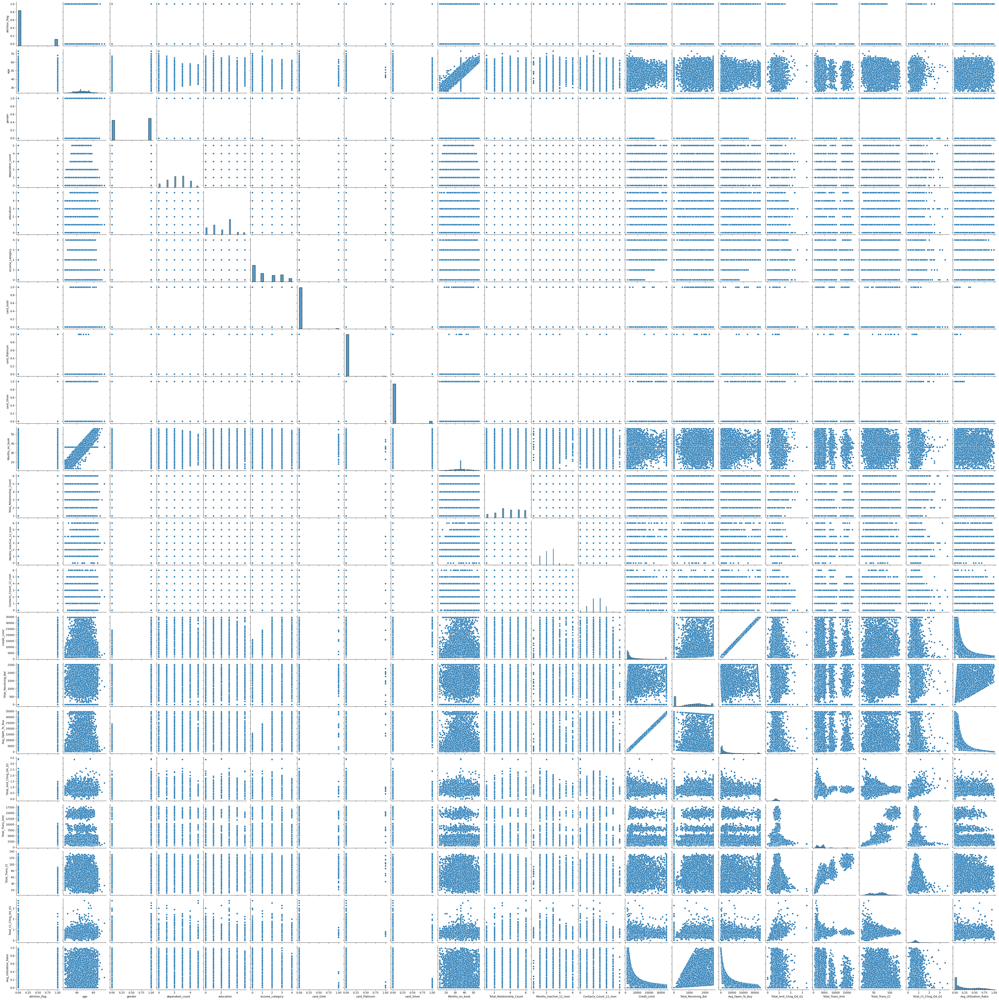

In [33]:
sn.pairplot(data=df_processed)

In [34]:
from sklearn.utils.class_weight import compute_class_weight
y = df_processed['attrition_flag']
y.value_counts()

0    5968
1    1113
Name: attrition_flag, dtype: int64

In [35]:
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y), y=y)
class_weights

array([0.59324732, 3.18104223])

In [36]:
class_weight_dict = {
    0: class_weights[0],
    1: class_weights[1]
}
class_weight_dict

{0: 0.5932473190348525, 1: 3.1810422282120396}

In [37]:
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV
from sklearn.preprocessing import MinMaxScaler

In [38]:
scaler = MinMaxScaler()

In [39]:
# X = scaler.fit_transform(df_processed.drop('attrition_flag', axis='columns'))

In [67]:
X = df_processed.drop('attrition_flag', axis='columns')

In [68]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
# skf = StratifiedKFold(n_splits=3) # 3 fold as asked in the question
# skf_scores = cross_val_score(model, X, y, cv=skf)

# model_rf = DecisionTreeClassifier(,random_state=69)
# skf = StratifiedKFold(n_splits=2) 
# skf_scores_rf = cross_val_score(model_dt, X, y, cv=skf,scoring='roc_auc')
# print(skf_scores_rf.mean())


In [69]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size= 0.25, random_state =69)

In [70]:
# dt_model = DecisionTreeClassifier( criterion='gini', splitter='best', 
#                                   max_depth=None, min_samples_split=2, 
#                                   min_samples_leaf=10, min_weight_fraction_leaf=0.0, 
#                                   max_features='auto', random_state=69,
#                                   max_leaf_nodes=None, min_impurity_decrease=0.0, 
#                                   class_weight='balanced', ccp_alpha=0.0)

In [71]:
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score

In [72]:
for num in range(2,20):
    dtc = DecisionTreeClassifier( criterion='gini', splitter='best', 
                                  max_depth=12, min_samples_split=2, 
                                  min_samples_leaf=5, min_weight_fraction_leaf=0.0, 
                                  max_features='auto', random_state=69,
                                  max_leaf_nodes=num, min_impurity_decrease=0.0, 
                                  class_weight='balanced', ccp_alpha=0.0)
    dtc.fit(x_train,y_train)
    pred = dtc.predict(x_test)
    
    print('For max_leaf_nodes = %s' % num)
    print('F1 Score',f1_score(pred,y_test))
    print('AccuracyScore', accuracy_score(pred,y_test))
    print('Recall',recall_score(pred,y_test))
    print('Precision',precision_score(pred,y_test))
    print('Clusters = ',np.unique(pred))
    print()

For max_leaf_nodes = 2
F1 Score 0.32989690721649484
AccuracyScore 0.55957086391869
Recall 0.2171945701357466
Precision 0.6857142857142857
Clusters =  [0 1]

For max_leaf_nodes = 3
F1 Score 0.4909090909090909
AccuracyScore 0.841897233201581
Recall 0.5
Precision 0.48214285714285715
Clusters =  [0 1]

For max_leaf_nodes = 4
F1 Score 0.49408672798948744
AccuracyScore 0.782608695652174
Recall 0.3908523908523909
Precision 0.6714285714285714
Clusters =  [0 1]

For max_leaf_nodes = 5
F1 Score 0.5807504078303426
AccuracyScore 0.854884246188594
Recall 0.5345345345345346
Precision 0.6357142857142857
Clusters =  [0 1]

For max_leaf_nodes = 6
F1 Score 0.5807504078303426
AccuracyScore 0.854884246188594
Recall 0.5345345345345346
Precision 0.6357142857142857
Clusters =  [0 1]

For max_leaf_nodes = 7
F1 Score 0.5807504078303426
AccuracyScore 0.854884246188594
Recall 0.5345345345345346
Precision 0.6357142857142857
Clusters =  [0 1]

For max_leaf_nodes = 8
F1 Score 0.5687789799072642
AccuracyScore 0.8424

In [63]:
# model_rf = DecisionTreeClassifier(,random_state=69)
# skf = StratifiedKFold(n_splits=2) 
# skf_scores_rf = cross_val_score(model_dt, X, y, cv=skf,scoring='roc_auc')
# print(skf_scores_rf.mean())

In [93]:
num = 7
dtc = DecisionTreeClassifier( criterion='gini', splitter='best', 
                                  max_depth=None, min_samples_split=10, 
                                  min_samples_leaf=2, min_weight_fraction_leaf=0.0, 
                                  max_features='auto', random_state=100,
                                  max_leaf_nodes=num, min_impurity_decrease=0.0, 
                                  class_weight='balanced', ccp_alpha=0.0)

skf = StratifiedKFold(n_splits=2) 
skf_scores_rf = cross_val_score(dtc, X, y, cv=skf,scoring='roc_auc')
print(skf_scores_rf.mean())



dtc.fit(X,y)

0.6986696602005749


DecisionTreeClassifier(class_weight='balanced', max_features='auto',
                       max_leaf_nodes=7, min_samples_leaf=2,
                       min_samples_split=10, random_state=100)

In [94]:
feats = X.columns

In [95]:
text_representation = tree.export_text(dtc)
print(text_representation)

|--- feature_18 <= 0.54
|   |--- feature_17 <= 63.50
|   |   |--- feature_19 <= 0.03
|   |   |   |--- class: 1
|   |   |--- feature_19 >  0.03
|   |   |   |--- feature_16 <= 1757.00
|   |   |   |   |--- class: 1
|   |   |   |--- feature_16 >  1757.00
|   |   |   |   |--- class: 1
|   |--- feature_17 >  63.50
|   |   |--- class: 0
|--- feature_18 >  0.54
|   |--- feature_19 <= 0.03
|   |   |--- class: 1
|   |--- feature_19 >  0.03
|   |   |--- feature_17 <= 57.50
|   |   |   |--- class: 0
|   |   |--- feature_17 >  57.50
|   |   |   |--- class: 0



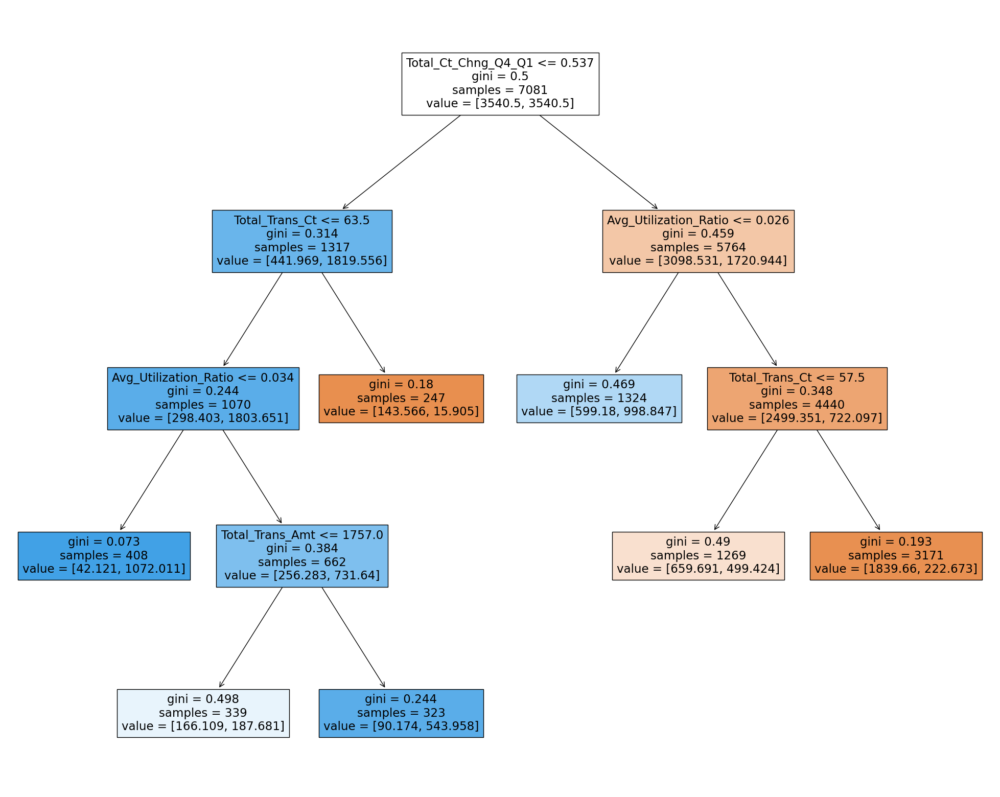

In [96]:
fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(dtc, feature_names=feats,filled=True)

TotalTransCt Total Transaction Count (Last 12 months)
TotalCtChngQ4Q1 Change in Transaction Count (Q4 over Q1)
AvgUtilizationRatio Average Card Utilization Ratio


In [97]:
def get_rules(tree, feature_names, class_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    paths = []
    path = []
    
    def recurse(node, path, paths):
        
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            p1, p2 = list(path), list(path)
            p1 += [f"({name} <= {np.round(threshold, 3)})"]
            recurse(tree_.children_left[node], p1, paths)
            p2 += [f"({name} > {np.round(threshold, 3)})"]
            recurse(tree_.children_right[node], p2, paths)
        else:
            path += [(tree_.value[node], tree_.n_node_samples[node])]
            paths += [path]
            
    recurse(0, path, paths)

    # sort by samples count
    samples_count = [p[-1][1] for p in paths]
    ii = list(np.argsort(samples_count))
    paths = [paths[i] for i in reversed(ii)]
    
    rules = []
    for path in paths:
        rule = ""
        for p in path[:-1]:
            if rule != "":
                rule += " & "
            rule += str(p.strip('()'))
        rules += [rule]
        
    return rules

In [98]:
clustering_df = x_train.copy()
clustering_df['LabelOfCluster'] = -1

In [99]:
from sklearn.tree import _tree
rules = get_rules(dtc, feats, None)
for r in rules:
    print(r)

Total_Ct_Chng_Q4_Q1 > 0.537 & Avg_Utilization_Ratio > 0.026 & Total_Trans_Ct > 57.5
Total_Ct_Chng_Q4_Q1 > 0.537 & Avg_Utilization_Ratio <= 0.026
Total_Ct_Chng_Q4_Q1 > 0.537 & Avg_Utilization_Ratio > 0.026 & Total_Trans_Ct <= 57.5
Total_Ct_Chng_Q4_Q1 <= 0.537 & Total_Trans_Ct <= 63.5 & Avg_Utilization_Ratio <= 0.034
Total_Ct_Chng_Q4_Q1 <= 0.537 & Total_Trans_Ct <= 63.5 & Avg_Utilization_Ratio > 0.034 & Total_Trans_Amt <= 1757.0
Total_Ct_Chng_Q4_Q1 <= 0.537 & Total_Trans_Ct <= 63.5 & Avg_Utilization_Ratio > 0.034 & Total_Trans_Amt > 1757.0
Total_Ct_Chng_Q4_Q1 <= 0.537 & Total_Trans_Ct > 63.5


In [100]:
#%%timeit
rules = get_rules(dtc, feats, None)
i=0
final_df = pd.DataFrame()
for r in rules:
    temp_df = clustering_df.query(r)
    temp_df['LabelOfCluster'].replace(-1, i, inplace=True)
    final_df = final_df.append(temp_df)
    i=i+1

In [101]:
final_df

,age,gender,dependent_count,education,income_category,card_Gold,card_Platinum,card_Silver,Months_on_book,Total_Relationship_Count,...,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,LabelOfCluster
9966,57,0,1,3,0,0,0,0,52,5,...,2,7882.0,1101,6781.0,0.682,14651,120,0.600,0.140,0
2080,36,0,2,4,0,0,0,0,25,5,...,4,8917.0,1091,7826.0,1.152,3327,80,0.860,0.122,0
5583,38,1,1,2,2,0,0,0,36,4,...,2,2836.0,862,1974.0,0.772,4121,83,0.694,0.304,0
5061,45,0,2,0,0,0,0,0,38,3,...,1,7486.0,1758,5728.0,0.613,4604,70,0.707,0.235,0
4071,50,0,1,1,0,0,0,0,44,4,...,1,3222.0,1422,1800.0,0.662,4613,72,0.600,0.441,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8995,52,1,2,1,3,0,0,0,46,2,...,3,25737.0,1168,24569.0,0.718,7722,94,0.469,0.045,6
2475,46,0,4,1,0,0,0,0,28,6,...,4,3206.0,0,3206.0,1.065,3253,72,0.532,0.000,6
3930,45,0,4,1,0,0,0,0,34,6,...,1,2484.0,1543,941.0,0.703,3802,68,0.447,0.621,6
5895,59,0,2,1,0,0,0,0,48,6,...,1,2338.0,1566,772.0,0.533,3964,69,0.500,0.670,6


In [102]:
# sell mdeical insurance 
# sell diabetes kit
# sell docotos appointment
# sell insulin 
# sell vitamins eatebles 
# sell weight loose machine